In [1]:
import numpy as np
import os
from PIL import Image
import matplotlib.pyplot as plt

## Configurations

In [2]:
# RENDERING PARAMETERS
expr_name = "dropout/chair_16v_left"
num_iterations = 30000

# set either dropout_ratio or ssim_decr_margin
dropout_ratio = None
ssim_decr_margin = 0.02

# masked uncertainty thresholds
thresholds = [0.01, 0.05, 0.1, 0.2]

## Read Rendered and G.T. Images

In [3]:
def get_dir_paths_gs(expr_name, num_iterations, ssim_decr_margin=None, dropout_ratio=None):
    if ssim_decr_margin is not None and dropout_ratio is not None:
        raise ValueError("Both dropout_ratio and ssim_decr_margin cannot be set at the same time.")
    model_dir = f"output/{expr_name}"
    if ssim_decr_margin is not None:
        train_dir = model_dir + f"/train/ours_{num_iterations}_ssim_decr_{ssim_decr_margin}/"
        test_dir = model_dir + f"/test/ours_{num_iterations}_ssim_decr_{ssim_decr_margin}/"
        
        # Read dropout ratio used for rendering
        with open(train_dir + "dropout_ratio.txt", "r") as f:
            dropout_ratio = float(f.read())

    elif dropout_ratio is not None:
        train_dir = model_dir + f"/train/ours_{num_iterations}_dropout_{dropout_ratio}/"
        test_dir = model_dir + f"/test/ours_{num_iterations}_dropout_{dropout_ratio}/"
    else:
        raise ValueError("Either dropout_ratio or ssim_decr_margin must be set.")
    return model_dir, train_dir, test_dir, dropout_ratio


def get_images_from_dir(images_dir, normalize=True):
    if not os.path.exists(images_dir):
        return []
    images = []
    images_files = sorted([f for f in os.listdir(images_dir) if f.endswith('.png')])
    for file in images_files:
        img_path = os.path.join(images_dir, file)
        img = Image.open(img_path)
        images.append(np.array(img))
    images = np.array(images)

    # Normalize images between 0 and 1
    if normalize and images.max() > 1:
        images = images / 255.0
    
    return images


def get_images_from_dir_of_dirs(images_dir, normalize=True):
    images = []
    images_dirs = sorted([d for d in os.listdir(images_dir)])
    for image_dir in images_dirs:
        images_full_dir = os.path.join(images_dir, image_dir)
        image = get_images_from_dir(images_full_dir, normalize)
        images.append(image)
    images = np.array(images)
    return images


def get_images_gs(images_dir):
    # Get all the ground truth images
    gt_dir = os.path.join(images_dir, 'gt')
    gt_images = get_images_from_dir(gt_dir) # [num_images, height, width, channels]

    # Get all the rendered images
    renders_dir = os.path.join(images_dir, 'renders')
    rendered_images = get_images_from_dir_of_dirs(renders_dir) # [num_images, num_samples, height, width, channels]
    
    return gt_images, rendered_images

In [4]:
# Get the directories to read the images from
model_dir, train_dir, test_dir, dropout_ratio = get_dir_paths_gs(expr_name, num_iterations, ssim_decr_margin, dropout_ratio)

print(f"Model dir:      {model_dir}")
print(f"Train dir:      {train_dir}")
print(f"Test dir:       {test_dir}")
print(f"Dropout ratio:  {dropout_ratio}")

Model dir:      output/dropout/chair_16v_left
Train dir:      output/dropout/chair_16v_left/train/ours_30000_ssim_decr_0.02/
Test dir:       output/dropout/chair_16v_left/test/ours_30000_ssim_decr_0.02/
Dropout ratio:  0.24


In [5]:
# Read the images
gt_train_images, rendered_train_images = get_images_gs(train_dir)
gt_test_images, rendered_test_images = get_images_gs(test_dir)

print(f"Train images:   GT:  {gt_train_images.shape},   Rendered:  {rendered_train_images.shape}")
print(f"Test images:    GT:  {gt_test_images.shape},    Rendered:  {rendered_test_images.shape}")

Train images:   GT:  (16, 800, 800, 3),   Rendered:  (16, 100, 800, 800, 3)
Test images:    GT:  (25, 800, 800, 3),    Rendered:  (25, 100, 800, 800, 3)


## Get Pred. Images, Pred. Errors, and Uncertainty Maps

In [6]:
def to_grayscale(images):
    return np.dot(images, [0.2989, 0.5870, 0.1140]) # ref. to https://stackoverflow.com/a/12201744

def get_std_images(images):
    # Convert to grayscale
    if images.shape[-1] == 3:
        images = to_grayscale(images)
    std_images = np.std(images, axis=1) # [num_images, num_samples, height, width] -> [num_images, height, width]
    return std_images

def get_mean_images(images):
    mean_images = np.mean(images, axis=1) # [num_images, num_samples, height, width, channels] -> [num_images, height, width, channels]
    return mean_images

def get_rmse_image(gt_image, pred_image):
    rmse_image = np.sqrt(np.mean((gt_image - pred_image) ** 2, axis=-1)) # RMSE across the channels; [height, width, channels] -> [height, width]
    return rmse_image

def get_rmse_images(gt_images, pred_images):
    rmse_images = []
    for gt_image, pred_image in zip(gt_images, pred_images):
        rmse_image = get_rmse_image(gt_image, pred_image)
        rmse_images.append(rmse_image)
    return np.array(rmse_images)

In [7]:
# Predicted Images (mean)
mean_train_images = get_mean_images(rendered_train_images)
mean_test_images = get_mean_images(rendered_test_images)

# Prediction Errors (RMSE)
rmse_train_images = get_rmse_images(gt_train_images, mean_train_images)
rmse_test_images = get_rmse_images(gt_test_images, mean_test_images)

# Uncertainty Maps (std)
std_train_images = get_std_images(rendered_train_images)
std_test_images = get_std_images(rendered_test_images)

print(f"Train images:   Mean:  {mean_train_images.shape},   RMSE:  {rmse_train_images.shape},   STD:  {std_train_images.shape}")
print(f"Test images:    Mean:  {mean_test_images.shape},    RMSE:  {rmse_test_images.shape},    STD:  {std_test_images.shape}")

Train images:   Mean:  (16, 800, 800, 3),   RMSE:  (16, 800, 800),   STD:  (16, 800, 800)
Test images:    Mean:  (25, 800, 800, 3),    RMSE:  (25, 800, 800),    STD:  (25, 800, 800)


## Performance Metrics

In [8]:
from skimage.metrics import structural_similarity as compare_ssim
from scipy.stats import pearsonr, spearmanr
from scipy.integrate import trapz

def compute_psnr(gt_image, pred_image):
    mse = np.mean((gt_image - pred_image) ** 2)
    return 20 * np.log10(255) - 10 * np.log10(mse)

def compute_psnrs(gt_images, pred_images):
    psnrs = []
    for gt_image, pred_image in zip(gt_images, pred_images):
        psnr = compute_psnr(gt_image, pred_image)
        psnrs.append(psnr)
    return np.array(psnrs)


def compute_ssim(gt_image, pred_image):
    return compare_ssim(gt_image, pred_image, data_range=pred_image.max() - pred_image.min(), multichannel=True, channel_axis=-1)


def compute_ssims(gt_images, pred_images):
    ssims = []
    for gt_image, pred_image in zip(gt_images, pred_images):
        ssim = compute_ssim(gt_image, pred_image)
        ssims.append(ssim)
    return np.array(ssims)


def compute_correlations(error_images, std_images, type='pearson'):
    correlations = []
    for error_image, std_image in zip(error_images, std_images):
        if type == 'pearson':
            corr, _ = pearsonr(error_image.flatten(), std_image.flatten())
        elif type == 'spearman':
            corr, _ = spearmanr(error_image.flatten(), std_image.flatten())
        else:
            raise ValueError(f"Invalid correlation type: {type}")
        correlations.append(corr)
    return np.array(correlations)


def compute_ause(error_image, std_image):
    """
    Ref. to https://arxiv.org/pdf/2203.10192 (Section 5, Metrics):
    Concretely, given an error metric (e.g. RMSE), 
    we obtain two lists by sorting the values of all the pixels according to their uncertainty and the error computed from the ground-truth. 
    By removing the top t%(t = 1 ∼ 100) of the errors in each vector and repeatedly computing the average of the last subset, 
    we can obtain the sparsification curve and the oracle curve respectively. 
    The area between them is the AUSE, which evaluates how much the uncertainty is correlated with the predicted error.
    """
    errors = error_image.flatten()
    uncertainties = std_image.flatten()

    # Indices to sort errors
    sort_idx_uncertainty = np.argsort(uncertainties)
    sort_idx_error = np.argsort(errors)
    
    # Remove the top t% of the errors in each vector
    sparsification_curve = []
    oracle_curve = []

    for t in range(1, 100): # at t=100 we would have removed all the points and the AUSE would be 0 (=> not considered)
        num_points = len(errors)
        num_points_to_keep = int(num_points * (1 - t / 100))

        # remove the top t% of the points based on uncertainty (sparsification curve)
        sparsified_errors = errors[sort_idx_uncertainty][:num_points_to_keep]
        sparsification_curve.append(np.mean(sparsified_errors))

        # remove the top t% of the points based on error (oracle curve)
        oracle_curve.append(np.mean(errors[sort_idx_error][:num_points_to_keep]))

    # Calculate the AUSE
    ause = trapz(sparsification_curve) - trapz(oracle_curve)
    return ause


def compute_auses(error_images, std_images):
    auses = []
    for error_image, std_image in zip(error_images, std_images):
        ause = compute_ause(error_image, std_image)
        auses.append(ause)
    return np.array(auses)

In [9]:
# PREDICTION PERFORMANCE METRICS
# PSNR
psnr_train = compute_psnrs(gt_train_images, mean_train_images)
psnr_test = compute_psnrs(gt_test_images, mean_test_images)

# SSIM
ssim_train = compute_ssims(gt_train_images, mean_train_images)
ssim_test = compute_ssims(gt_test_images, mean_test_images)


# UNCERTAINTY PERFORMANCE METRICS
# Pearson correlation
pearson_corr_train = compute_correlations(rmse_train_images, std_train_images, type='pearson')
pearson_corr_test = compute_correlations(rmse_test_images, std_test_images, type='pearson')

# Spearman correlation
spearman_corr_train = compute_correlations(rmse_train_images, std_train_images, type='spearman')
spearman_corr_test = compute_correlations(rmse_test_images, std_test_images, type='spearman')

# AUSE RMSE
ause_train = compute_auses(rmse_train_images, std_train_images)
ause_test = compute_auses(rmse_test_images, std_test_images)

## Results

In [10]:
def show_results(gt_images, mean_images, std_images, rmse_images, psnrs, ssims, pearson_corr, spearman_corr, ause, train_test='unknown'):
    assert len(gt_images) == len(mean_images) and len(mean_images) == len(std_images), "The number of gt, mean, and std images mustshould match."
    
    num_images = len(gt_images)
    for i in range(num_images):
        fig, axs = plt.subplots(1, 5, figsize=(30, 5))
        
        if train_test == 'train' or train_test == 'test':
            fig.suptitle(f"{train_test.capitalize()} image {i} - PSNR: {psnrs[i]:.2f}, SSIM: {ssims[i]:.4f}, Pearson: {pearson_corr[i]:.4f}, Spearman: {spearman_corr[i]:.4f}, AUSE: {ause[i]:.4f}")
        
        axs[0].imshow(gt_images[i])
        axs[0].set_title("RBG Ground Truth")
        axs[0].axis('off')

        axs[1].imshow(mean_images[i])
        axs[1].set_title("RGB Prediction")
        axs[1].axis('off')

        axs[2].imshow(rmse_images[i], cmap='hot')
        axs[2].set_title("RMSE Image")
        axs[2].axis('off')
        
        axs[3].imshow(std_images[i], cmap='hot')
        axs[3].set_title(f"Uncertainty Map")
        axs[3].axis('off')

        axs[4].scatter(rmse_images[i].flatten(), std_images[i].flatten(), s=1)
        axs[4].set_title(f'Scatter Plot')
        axs[4].set_xlabel('RMSE')
        axs[4].set_ylabel('Uncertainty')
        axs[4].grid(True)
        
        plt.tight_layout()
        plt.subplots_adjust(wspace=0.02, hspace=0.02, top=0.85, bottom=0.05, left=0.05, right=0.95)
        plt.show()

### Qualitative

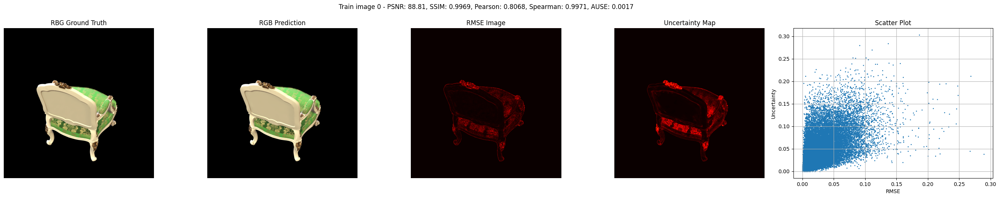

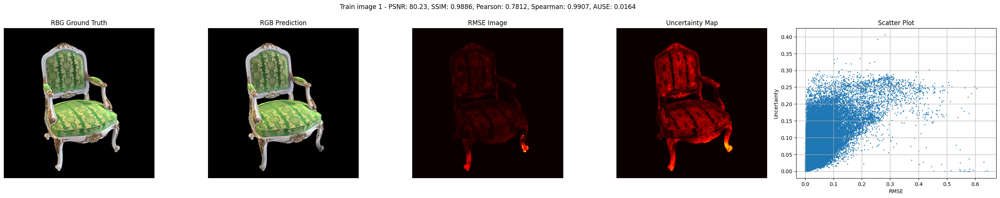

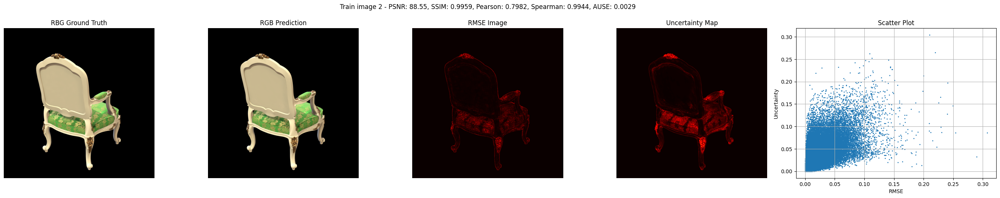

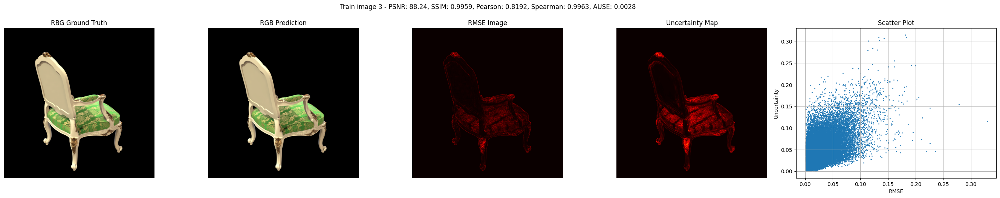

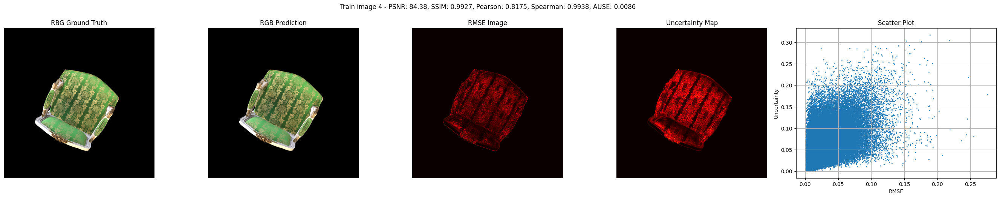

...

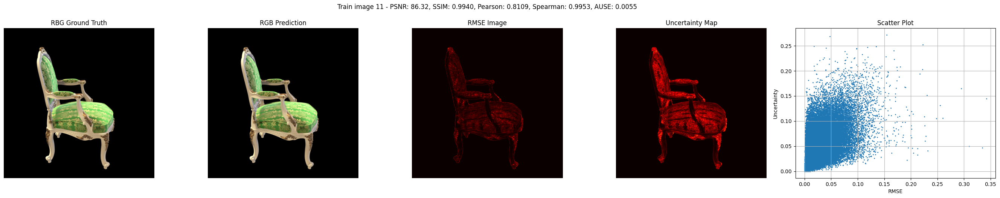

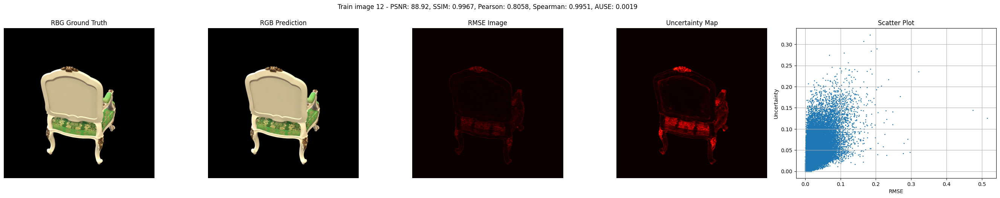

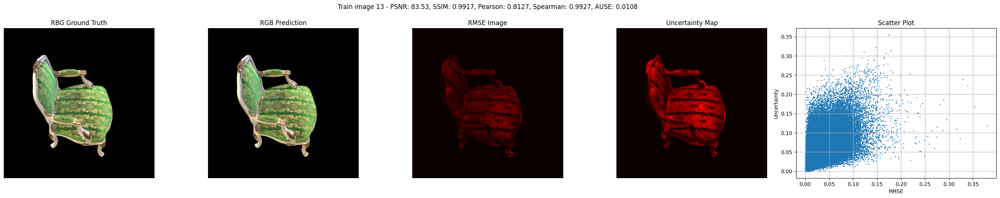

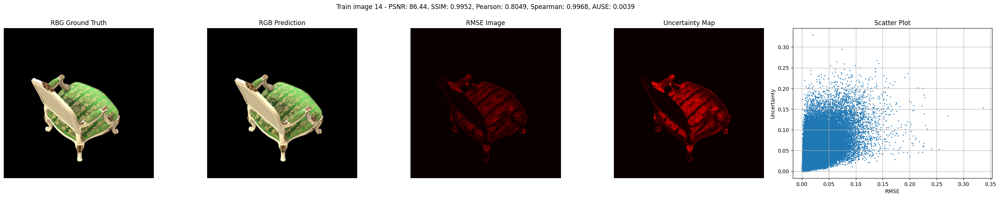

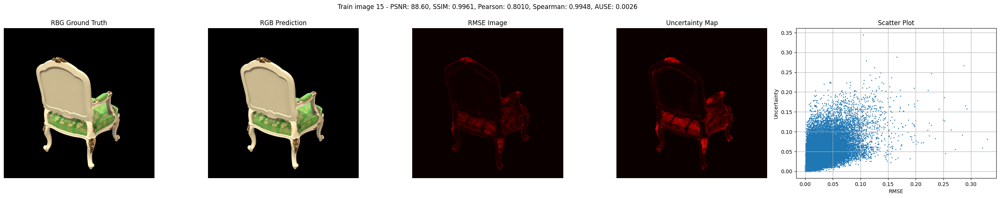

In [11]:
show_results(gt_train_images, mean_train_images, std_train_images, rmse_train_images, psnr_train, ssim_train, pearson_corr_train, spearman_corr_train, ause_train, train_test='train')


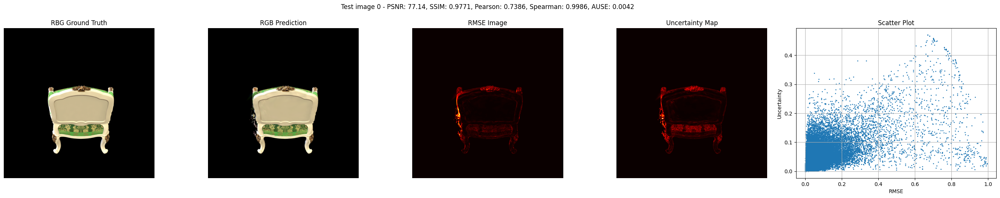

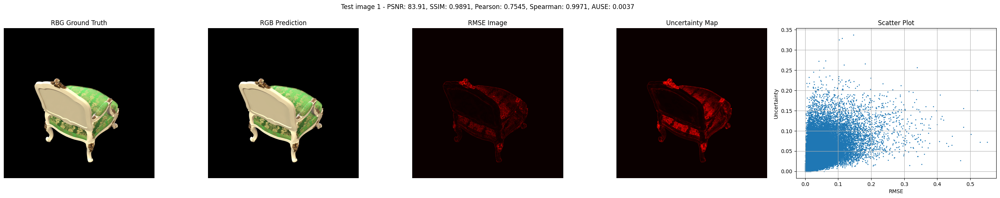

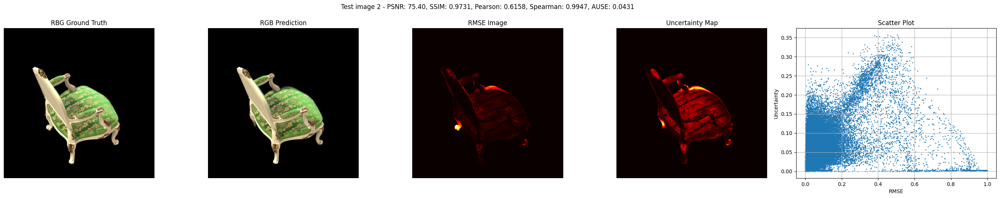

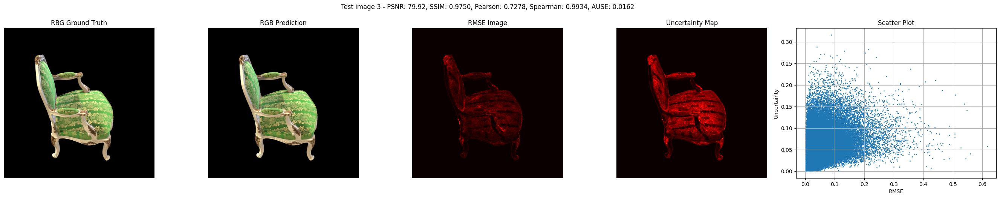

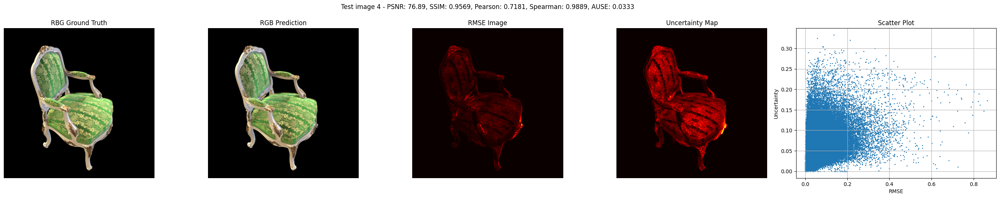

...

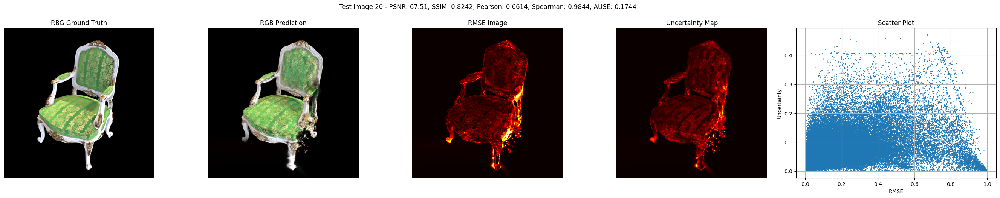

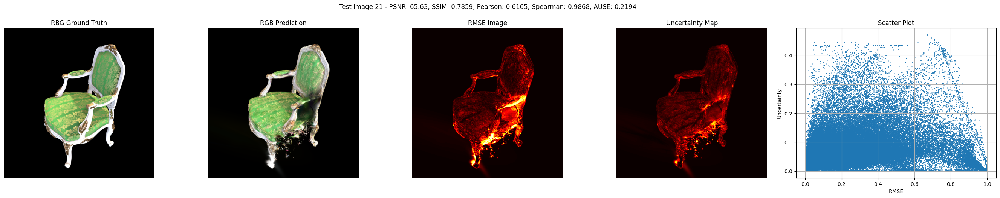

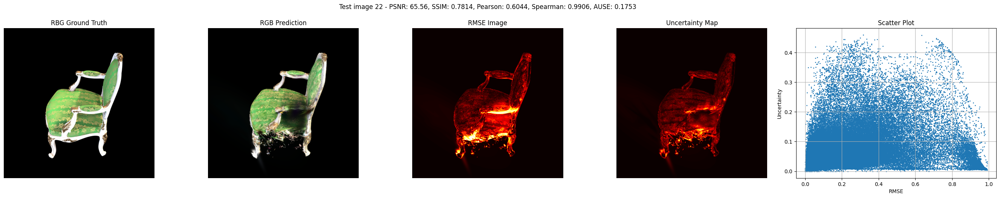

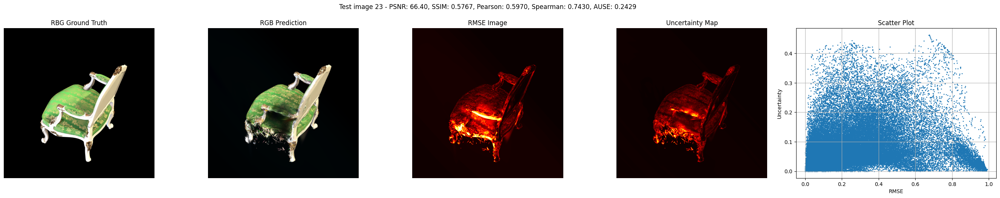

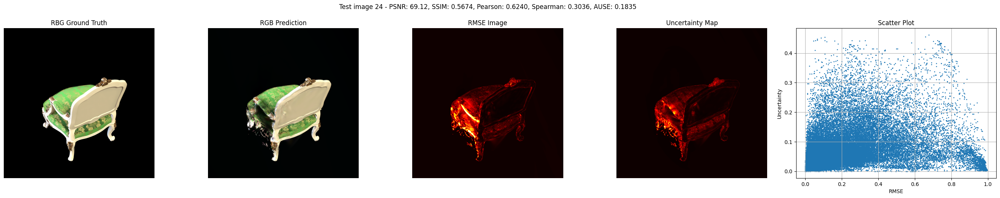

In [12]:
show_results(gt_test_images, mean_test_images, std_test_images, rmse_test_images, psnr_test, ssim_test, pearson_corr_test, spearman_corr_test, ause_test, train_test='test')

#### Quantitative

In [13]:
print("################ TRAIN ###############")
print(f"Average PSNR:                   {np.mean(psnr_train):.2f}")
print(f"Average SSIM:                   {np.mean(ssim_train):.4f}")
print(f"Average Pearson Correlation:    {np.mean(pearson_corr_train):.4f}")
print(f"Average Spearman Correlation:   {np.mean(spearman_corr_train):.4f}")
print(f"Average AUSE:                   {np.mean(ause_train):.4f}")
print()
print("################ TEST ################")
print(f"Average PSNR:                   {np.mean(psnr_test):.2f}")
print(f"Average SSIM:                   {np.mean(ssim_test):.4f}")
print(f"Average Pearson Correlation:    {np.mean(pearson_corr_test):.4f}")
print(f"Average Spearman Correlation:   {np.mean(spearman_corr_test):.4f}")
print(f"Average AUSE:                   {np.mean(ause_test):.4f}")

################ TRAIN ###############
Average PSNR:                   85.86
Average SSIM:                   0.9938
Average Pearson Correlation:    0.8003
Average Spearman Correlation:   0.9943
Average AUSE:                   0.0063

################ TEST ################
Average PSNR:                   72.43
Average SSIM:                   0.8709
Average Pearson Correlation:    0.6692
Average Spearman Correlation:   0.9508
Average AUSE:                   0.1003


## Masked Uncertainty (Top-x% Most Uncertain Pixels)

In [14]:
# Get the top-x% most uncertain pixels
def top_uncertain_mask(std_images, threshold=0.01):
    threshold = np.percentile(std_images, (1-threshold)*100)
    mask = np.where(std_images > threshold, 1.0, 0.0)
    return mask


def get_masked_std(std_images, thresholds=[0.01, 0.05, 0.1]):
    if type(thresholds) == float:
        threshold = [threshold]
    masked_stds = {}
    for threshold in thresholds:
        curr_masked_std = []
        for std_image in std_images:
            mask_image = top_uncertain_mask(std_image, threshold=threshold)
            curr_masked_std.append(mask_image)
        masked_stds[threshold] = np.array(curr_masked_std)
    return masked_stds


# Plot masked uncertainty on top of the mean image
def plot_uncertainty_on_pred(mean_images, std_images, rmse_images, std_masks, train_test='unknown'):
    num_images = len(mean_images)
    num_std_masks = len(std_masks)
    for i in range(num_images):
        fig, axs = plt.subplots(1, num_std_masks+2, figsize=(num_std_masks*5, 5))
        if train_test == 'train' or train_test == 'test':
            fig.suptitle(f"Uncertainty mask on {train_test} image {i}", fontsize=16)
        
        # Prediction without mask
        axs[0].imshow(mean_images[i])
        axs[0].set_title("RGB Prediction w/o mask")
        axs[0].axis('off')

        # RMSE Image
        axs[1].imshow(rmse_images[i], cmap='hot')
        axs[1].set_title("RMSE Image")
        axs[1].axis('off')

        # Prediction with mask given different threshold ratios
        for j, (threshold, std_mask) in enumerate(std_masks.items()):
            axs[j+2].imshow(mean_images[i])
            axs[j+2].imshow(std_images[i], cmap='hot', alpha=std_mask[i])
            axs[j+2].set_title(f"Threshold: {threshold}")
            axs[j+2].axis('off')

        plt.tight_layout()
        plt.show()

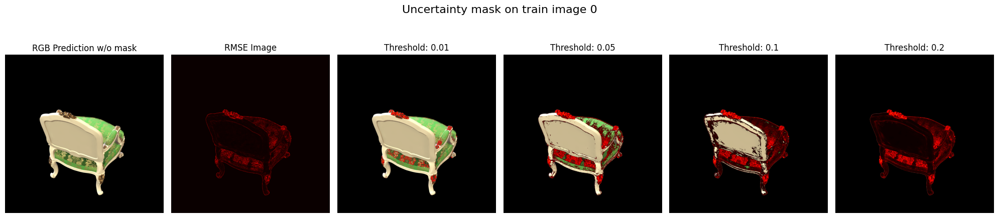

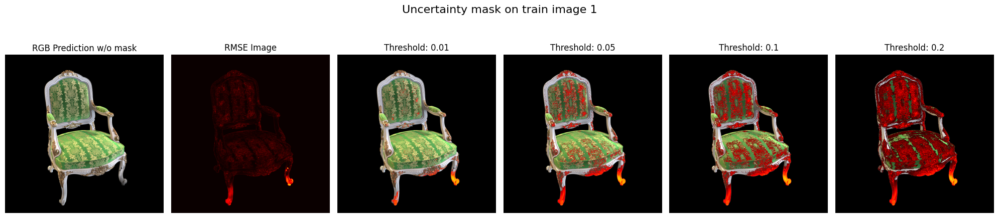

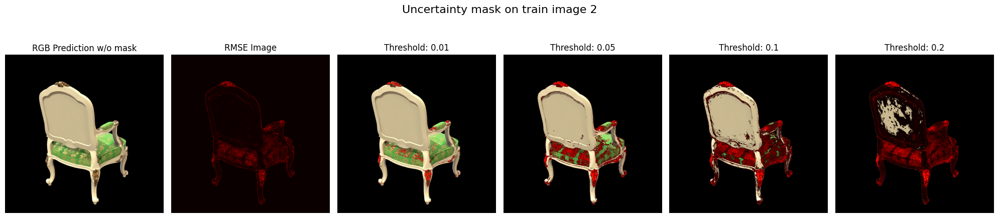

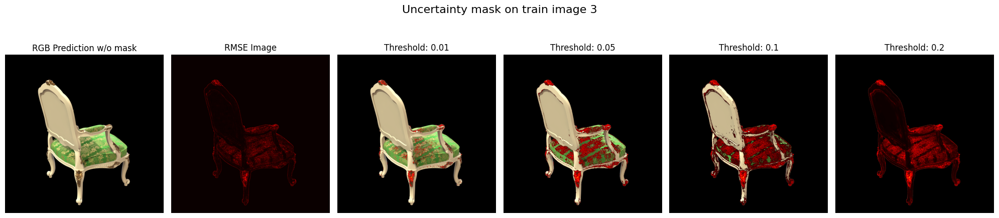

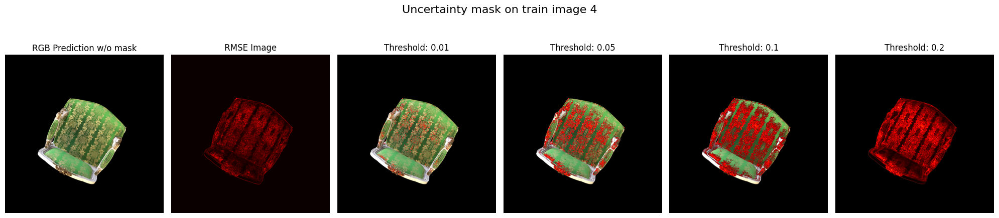

...

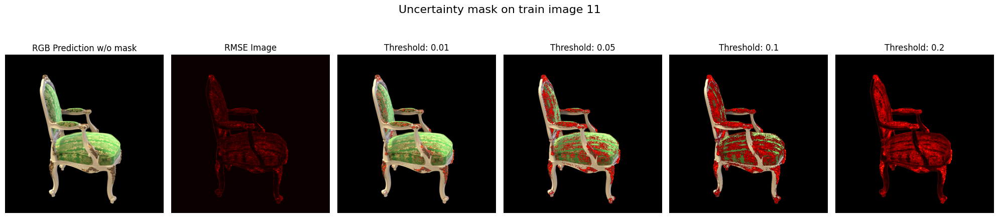

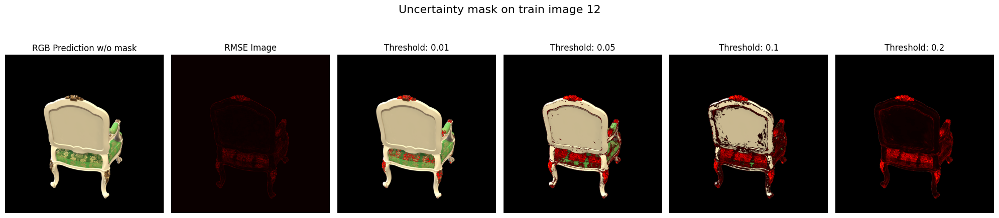

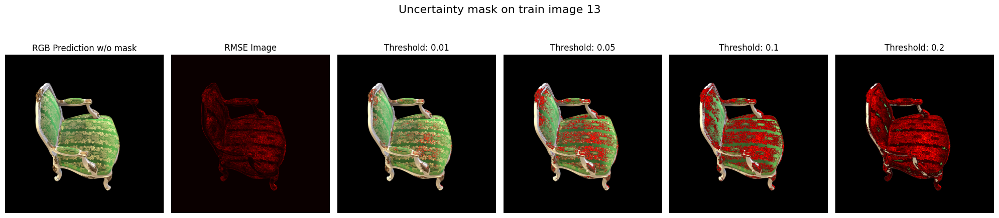

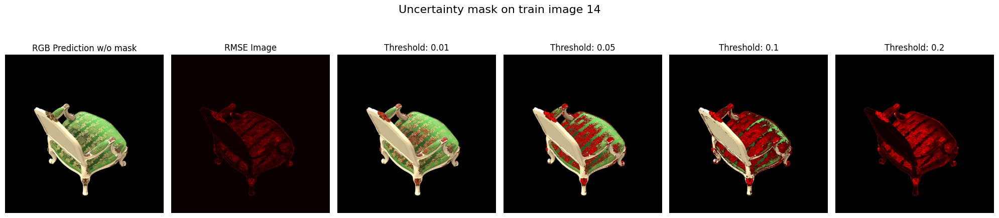

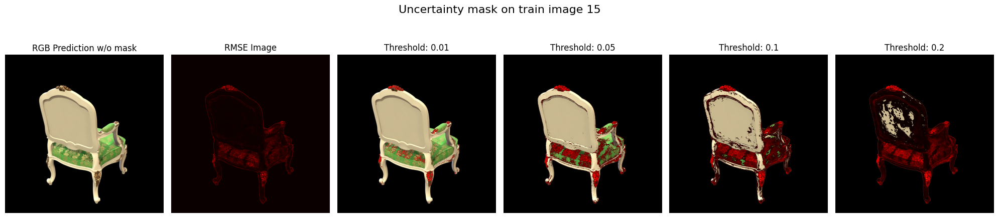

In [15]:
masked_stds_train = get_masked_std(std_train_images, thresholds=thresholds)
plot_uncertainty_on_pred(mean_train_images, std_train_images, rmse_train_images, masked_stds_train, train_test='train')

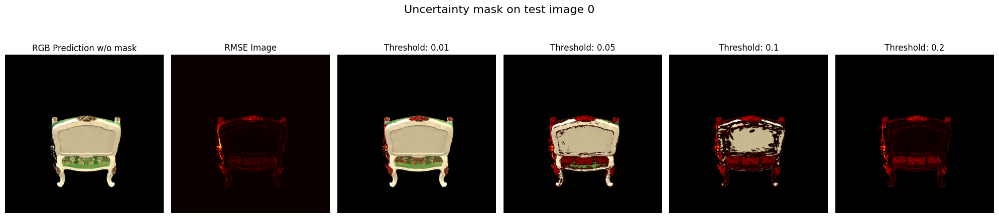

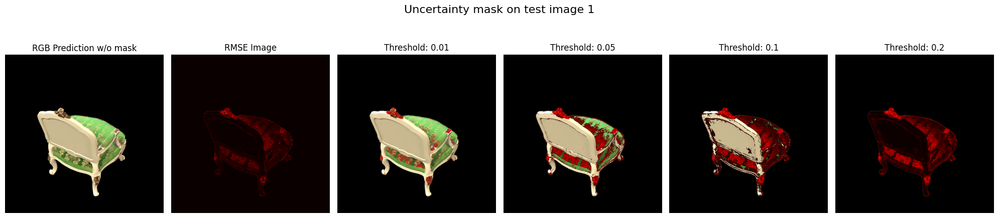

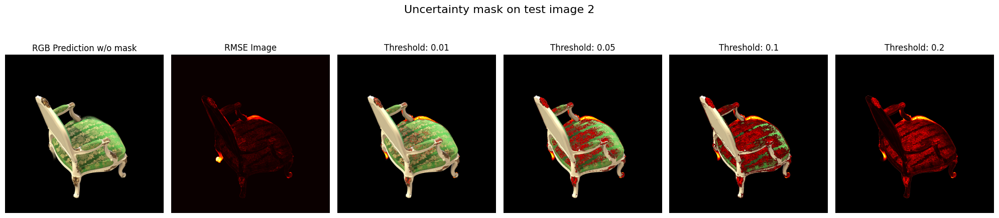

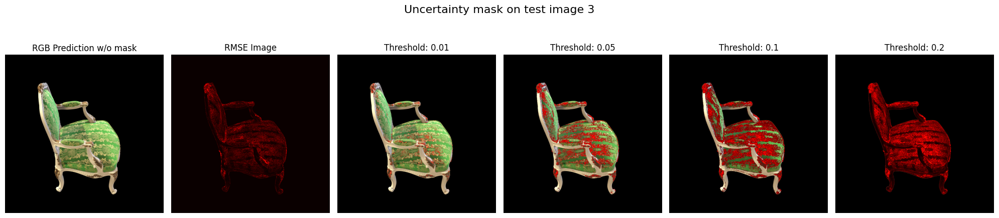

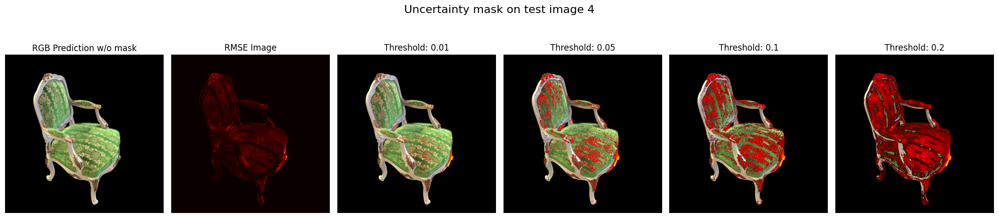

...

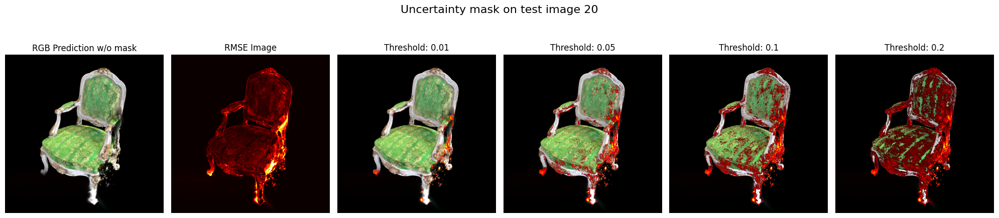

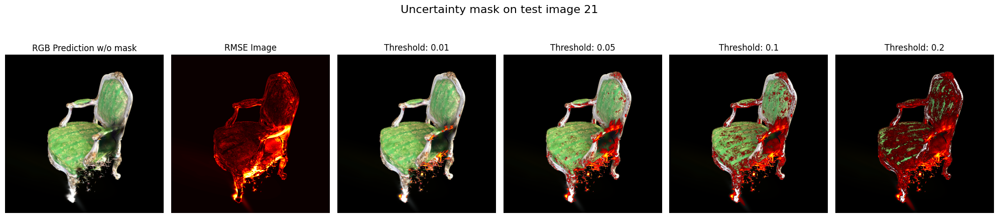

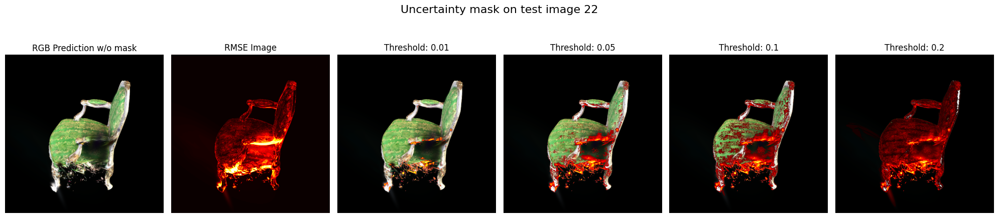

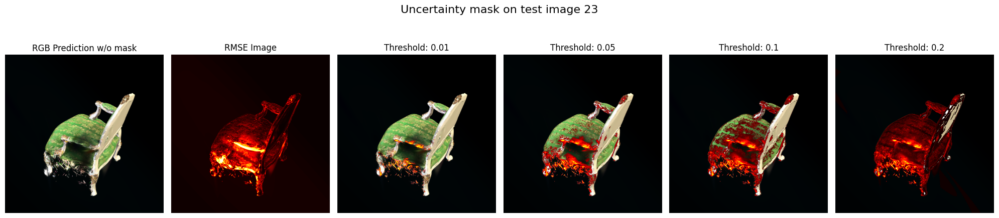

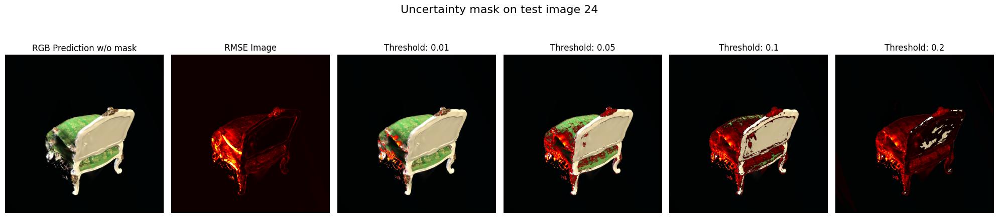

In [16]:
masked_stds_test = get_masked_std(std_test_images, thresholds=thresholds)
plot_uncertainty_on_pred(mean_test_images, std_test_images, rmse_test_images, masked_stds_test, train_test='test')

## Ensemble Uncertainty-Aware Rendering

### Get G.T. and pred. images w/o dropout

In [17]:
prim_dir = get_dir_paths_gs(expr_name, num_iterations, dropout_ratio=0.0)[2] + "renders/"
sec_dir = "/home/thanostriantafyllou/2d-gaussian-splatting/output/dropout/chair_16v_right/test/ours_30000_dropout_0.0/renders/"

In [18]:
gt_images = gt_test_images
std_images = std_test_images
prim_images = get_mean_images(get_images_from_dir_of_dirs(prim_dir))
sec_images = get_mean_images(get_images_from_dir_of_dirs(sec_dir))

print(f"G.T. images:        {gt_images.shape}")
print(f"Uncertainty maps:   {std_images.shape}")
print(f"Primary images:     {prim_images.shape}")
print(f"Secondary images:   {sec_images.shape}")
print(f"Thresholds:         {thresholds}")

G.T. images:        (25, 800, 800, 3)
Uncertainty maps:   (25, 800, 800)
Primary images:     (25, 800, 800, 3)
Secondary images:   (25, 800, 800, 3)
Thresholds:         [0.01, 0.05, 0.1, 0.2]


### Get Ensemble Uncertainty-Aware Images

In [19]:
# Top x-% most uncertain pixels are replaced by the secondary model
def get_ensemble_images(primary_images, secondary_images, std_images, threshold=0.01):
    if primary_images.shape != secondary_images.shape or primary_images.shape[:2] != std_images.shape[:2]:
        raise ValueError("Primary, secondary, and std images must have the same shape.")
    
    ensemble_images = []
    for primary_image, secondary_image, std_image in zip(primary_images, secondary_images, std_images):
        mask = top_uncertain_mask(std_image, threshold=threshold)
        if primary_image.shape[-1] == 3:
            mask = np.expand_dims(mask, axis=-1)
        ensemble_image = primary_image * (1 - mask) + secondary_image * mask
        ensemble_images.append(ensemble_image)
    return np.array(ensemble_images)

In [20]:
# Get the ensemble images for the specified thresholds
ensemble_images = {}
for threshold in thresholds:
    ensemble_images[threshold] = get_ensemble_images(prim_images, sec_images, std_images, threshold=threshold)

In [21]:
# Group all images together (for future evaluation)
images = {}
images['gt'] = gt_images
images['prim'] = prim_images
images['sec'] = sec_images
images['ensemble'] = ensemble_images

### Compute Prediction Performance Metrics

In [22]:
# Primary Images
prim_metrics = {}
prim_metrics['psnr'] = compute_psnrs(gt_images, prim_images)
prim_metrics['ssim'] = compute_ssims(gt_images, prim_images)

# Secondary Images
sec_metrics = {}
sec_metrics['psnr'] = compute_psnrs(gt_images, sec_images)
sec_metrics['ssim'] = compute_ssims(gt_images, sec_images)

# Ensemble Images
ensemble_metrics = {}
for threshold in thresholds:
    ensemble_metrics[threshold] = {}
    ensemble_metrics[threshold]['psnr'] = compute_psnrs(gt_images, ensemble_images[threshold])
    ensemble_metrics[threshold]['ssim'] = compute_ssims(gt_images, ensemble_images[threshold])

In [23]:
# Group all metrics together (for future evaluation)
metrics = {}
metrics['prim'] = prim_metrics
metrics['sec'] = sec_metrics
metrics['ensemble'] = ensemble_metrics

### Visualise Results

In [24]:
def show_ensemble_results(images, metrics):
    for i in range(len(images['gt'])):
        fig, axs = plt.subplots(1, len(thresholds)+3, figsize=(len(thresholds)*5, 5))
        fig.suptitle(f"Ensemble image {i}", fontsize=16)
        
        axs[0].imshow(images['gt'][i])
        axs[0].set_title("Ground Truth")
        axs[0].axis('off')

        axs[1].imshow(images['prim'][i])
        axs[1].set_title(f"Primary\nPSNR: {metrics['prim']['psnr'][i]:.2f}, SSIM: {metrics['prim']['ssim'][i]:.4f}")
        axs[1].axis('off')

        axs[2].imshow(images['sec'][i])
        axs[2].set_title(f"Secondary\nPSNR: {metrics['sec']['psnr'][i]:.2f}, SSIM: {metrics['sec']['ssim'][i]:.4f}")
        axs[2].axis('off')

        for j, threshold in enumerate(thresholds):
            axs[j+3].imshow(images['ensemble'][threshold][i])
            axs[j+3].set_title(f"Ensemble (T={threshold})\nPSNR: {metrics['ensemble'][threshold]['psnr'][i]:.2f}, SSIM: {metrics['ensemble'][threshold]['ssim'][i]:.4f}")
            axs[j+3].axis('off')
        
        plt.tight_layout()
        plt.show()

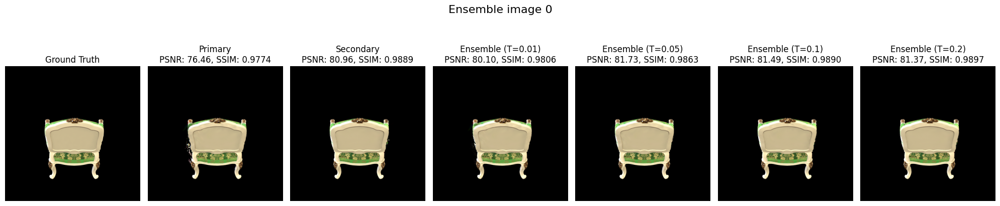

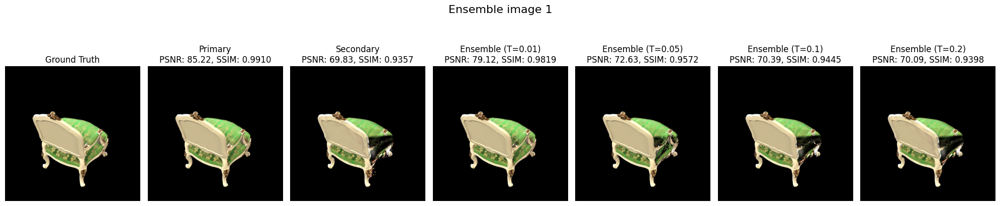

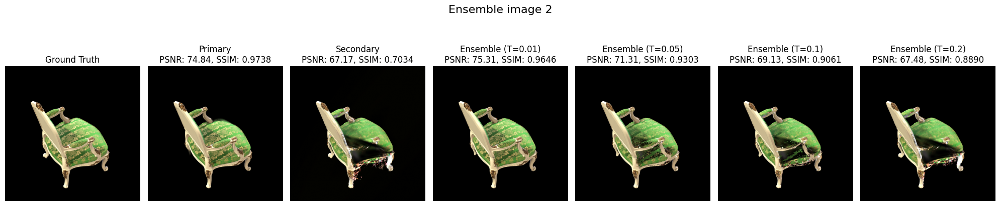

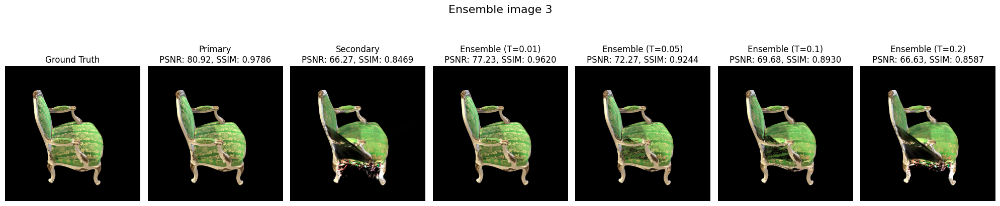

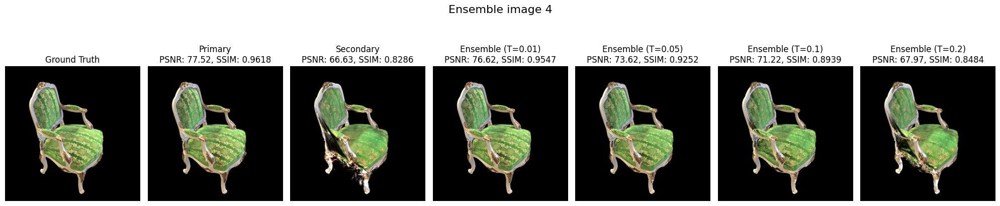

...

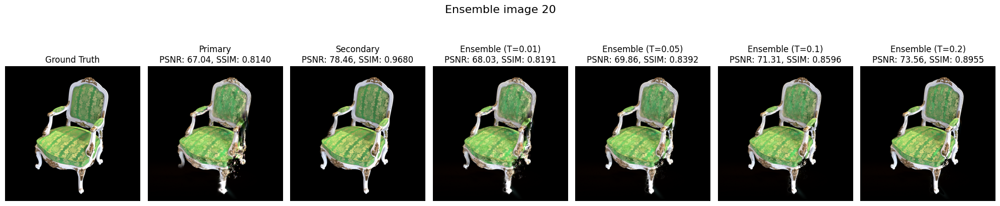

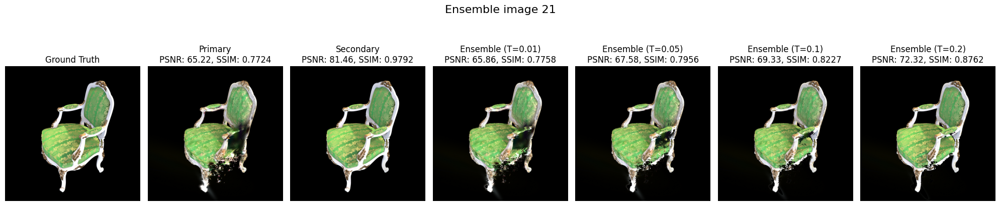

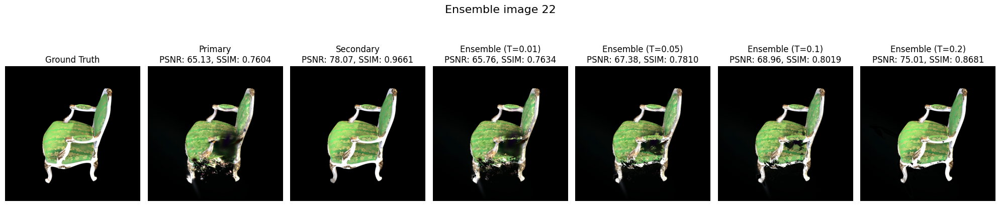

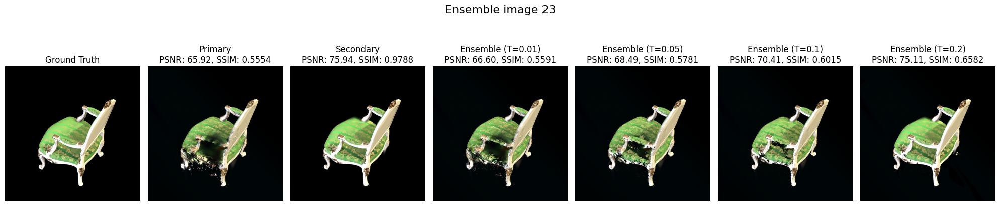

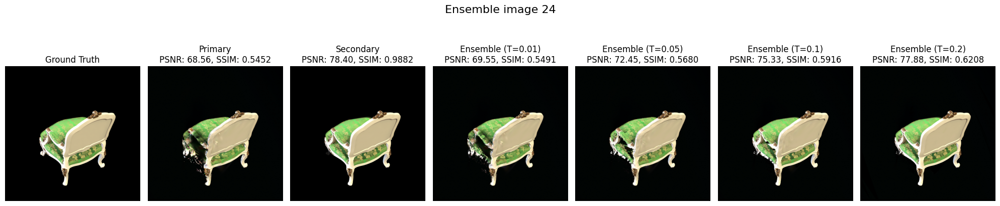

In [25]:
show_ensemble_results(images, metrics)

### Quantitative Results

In [26]:
print(f"Primary:             PSNR: {np.mean(prim_metrics['psnr']):.2f}, SSIM: {np.mean(prim_metrics['ssim']):.4f}")
print(f"Secondary:           PSNR: {np.mean(sec_metrics['psnr']):.2f}, SSIM: {np.mean(sec_metrics['ssim']):.4f}")
for threshold in thresholds:
    print(f"Ensemble (T={threshold:.2f}):   PSNR: {np.mean(metrics['ensemble'][threshold]['psnr']):.2f}, SSIM: {np.mean(metrics['ensemble'][threshold]['ssim']):.4f}")

Primary:             PSNR: 72.13, SSIM: 0.8649
Secondary:           PSNR: 72.05, SSIM: 0.8956
Ensemble (T=0.01):   PSNR: 71.76, SSIM: 0.8614
Ensemble (T=0.05):   PSNR: 70.82, SSIM: 0.8543
Ensemble (T=0.10):   PSNR: 70.61, SSIM: 0.8532
Ensemble (T=0.20):   PSNR: 71.16, SSIM: 0.8622
